In [1]:
# Imporitng the Libraries
import pandas as pd
import numpy as np
import plotly.express as px
import plotly.graph_objects as go

In [3]:
# Loading the Dataset
data =pd.read_csv('diamonds.csv')

In [5]:
# Analyse Top 5 rows of the Dataset
data.head()

,Unnamed: 0,carat,cut,color,clarity,depth,table,price,x,y,z
0,1,0.23,Ideal,E,SI2,61.5,55.0,326,3.95,3.98,2.43
1,2,0.21,Premium,E,SI1,59.8,61.0,326,3.89,3.84,2.31
2,3,0.23,Good,E,VS1,56.9,65.0,327,4.05,4.07,2.31
3,4,0.29,Premium,I,VS2,62.4,58.0,334,4.20,4.23,2.63
4,5,0.31,Good,J,SI2,63.3,58.0,335,4.34,4.35,2.75


In [7]:
# This Dataset contains an unnamed column. I will delete this column before moving further
data.drop(columns = 'Unnamed: 0', inplace= True)

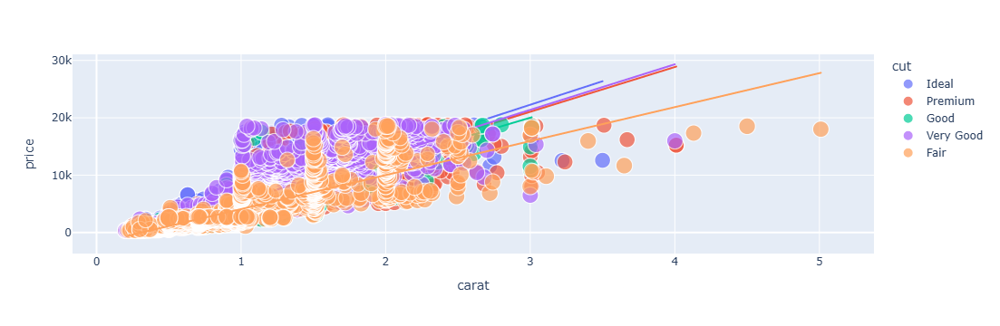

In [14]:
# I will first analyse the relationship between the carat and the price of the diamond to see how the number of carats affects the price of a diamond
figure = px.scatter(data, x = data['carat'], y = data['price'], trendline ='ols', color = 'cut', size = data['depth'])

figure.show()

##### We can see a linear relationship between the number of carats and the price of a diamond. It means higher carats result in higher prices


In [15]:
# Now lets add a new column by calculating the size (length X width X depth) of the diamond
data['size'] = data['x'] * data['y'] * data['z']
data.head()

,carat,cut,color,clarity,depth,table,price,x,y,z,size
0,0.23,Ideal,E,SI2,61.5,55.0,326,3.95,3.98,2.43,38.202030
1,0.21,Premium,E,SI1,59.8,61.0,326,3.89,3.84,2.31,34.505856
2,0.23,Good,E,VS1,56.9,65.0,327,4.05,4.07,2.31,38.076885
3,0.29,Premium,I,VS2,62.4,58.0,334,4.20,4.23,2.63,46.724580
4,0.31,Good,J,SI2,63.3,58.0,335,4.34,4.35,2.75,51.917250


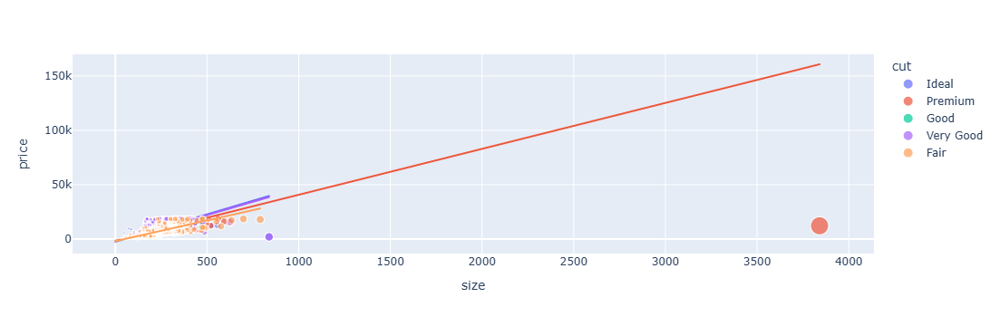

In [18]:
# Now let's have a look at the relationship between the size of a diamond and its price
figure = px.scatter(data, x = data['size'], y = data['price'], trendline= 'ols', size = 'size', color = 'cut')

figure.show()

##### The above visual concludes two features of diamonds
1. Premium-cut diamonds are relatively larger than other diamonds
2. There's a linear relationship between the size of all types of diamonds and their prices

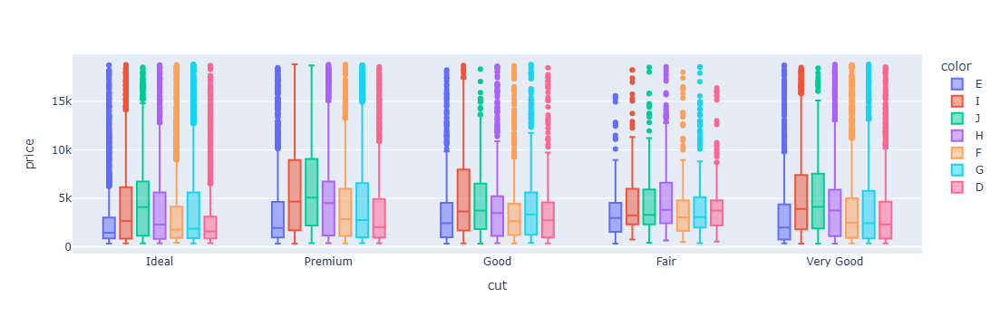

In [22]:
# Now let's have a look at the prices of all the types of diamonds based on their color
fig = px.box(data, x = data['cut'], y =data['price'], color = 'color')

fig.show()

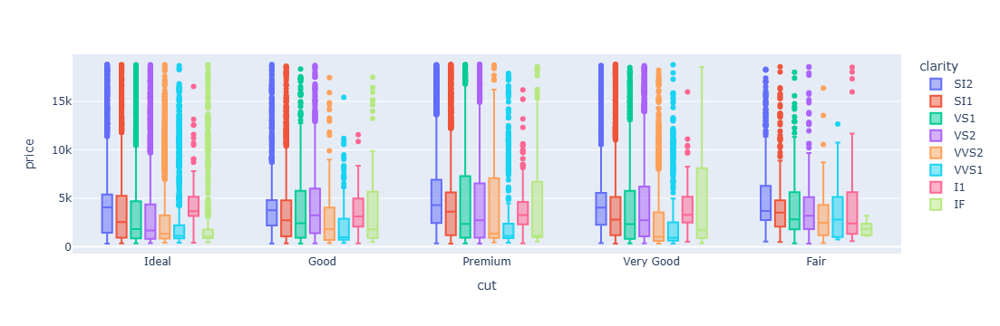

In [23]:
# Now let's have a look at the prices of all the types of diamonds based on their clarity
fig  = px.box(data, x = 'cut', y = 'price', color = 'clarity')

fig.show()

In [25]:
# Now let's have a look at the correlation between diamond prices and other features in the dataset
correlation = data.corr(numeric_only= True)
correlation['price'].sort_values(ascending= False)

price    1.000000
carat    0.921591
size     0.902385
x        0.884435
y        0.865421
z        0.861249
table    0.127134
depth   -0.010647
Name: price, dtype: float64

#### Diamond Price Prediction

##### Now, I will move to the task of predicting diamond prices by using all the necessary information from the diamond price analysis done above

In [26]:
# Now let's convert the values of the cut column as the cut type of diamonds is a valuable feature to predict the price 0f a diamond

data['cut'] = data['cut'].map({"Ideal": 1,
                              "Premium": 2,
                              "Good": 3,
                              "Very Good": 4,
                              "Fair": 5})

In [28]:
# Now let's split the data into training and test sets
from sklearn.model_selection import train_test_split

X = np.array(data[['carat', 'cut', 'size']])
y = np.array(data[['price']])

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size= 0.10, random_state= 42)

In [29]:
# Now let's train the machine learning model for the task of diamond price prediction
from sklearn.ensemble import RandomForestRegressor
model = RandomForestRegressor()
model.fit(X_train, y_train)

C:\Users\Kamran\anaconda3\anaconda_new\Lib\site-packages\sklearn\base.py:1473: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



RandomForestRegressor()

In [30]:
# Now we can use our machine learning model to predict the price of a diamond
print("Diamond Price Prediction")
a = float(input("Carat Size: "))
b = int(input('Cut Type (Ideal: 1, Premium: 2, Good: 3, Very Good: 4, Fair: 5 ): '))
c = float(input('size: '))

features = np.array([[a, b, c]])
print('Predicted Diamonds Price = ', model.predict(features))

Diamond Price Prediction


Carat Size:  0.80
Cut Type (Ideal: 1, Premium: 2, Good: 3, Very Good: 4, Fair: 5 ):  1
size:  50


Predicted Diamonds Price =  [1670.6725]


#### Summary

According to the diamond price analysis, we can say that the price and size of premium dimaonds are higher that other types of diamonds.